In [1]:
import do_mpc
import numpy as np
import matplotlib.pyplot as plt

from data.data_generation import data_generation
from src.model.dynamics_model import dynamics_model
from src.model.mpc_controller import mpc_controller
from src.model.mhe_estimator import mhe_estimator
from src.model.simulator import simulator
from src.util.question_selector import question_selector, benchmark1, benchmark2
from src.util.constants import *

from src.util.plotting import plotter

from casadi import lt

constants.py: S=50, C=1000, and K=9


In [2]:
# Time unit: 1 day

In [3]:
np.random.seed(seed=42)
# Obtain all configured modules and run the loop

phi, psi, ohm = data_generation()  # students, questions, involvements
model = dynamics_model(S, C, K)
mpc = mpc_controller(model)
mhe = mhe_estimator(model)
sim = simulator(model)
estimator = do_mpc.estimator.StateFeedback(model)

''' Use different initial state for the true system (simulator) and for MHE / MPC '''
x0_true = np.append(phi[4], [0, 0])
x0 = np.zeros(model.n_x).reshape((model.n_x, 1))                  # --> Shape = 10

# Initialize MPC, Sim and MHE
mpc.x0 = x0
sim.x0 = x0_true
mhe.x0 = x0
#estimator.x0 = x0

# Set initial guess for MHE/MPC based on initial state.
mpc.set_initial_guess()
mhe.set_initial_guess()

data_generation() constructed student data with shape (50, 9) and questions data with shape (2000, 9)
dynamics_model(): model type is discrete and symvars are SX


C:\Users\ricca\Anaconda3\envs\learning_analytics\lib\site-packages\do_mpc\controller.py:760: UserWarning: rterm was not set and defaults to zero. Changes in the control inputs are not penalized. Can lead to oscillatory behavior.
  warnings.warn('rterm was not set and defaults to zero. Changes in the control inputs are not penalized. Can lead to oscillatory behavior.')


In [4]:
import matplotlib.pyplot as plt
import matplotlib as mpl
# Customizing Matplotlib:
mpl.rcParams['font.size'] = 18
mpl.rcParams['lines.linewidth'] = 3
mpl.rcParams['axes.grid'] = True
mpc_graphics = do_mpc.graphics.Graphics(mpc.data)
mhe_graphics = do_mpc.graphics.Graphics(mhe.data)
sim_graphics = do_mpc.graphics.Graphics(sim.data)

In [5]:
%%capture
# We just want to create the plot and not show it right now. This "inline magic" supresses the output.
fig, ax = plt.subplots(2,2, sharex=True, figsize=(16,9))
fig.align_ylabels()

In [6]:
%%capture
for g in [sim_graphics, mpc_graphics, mhe_graphics]:
    # First axis:
    g.add_line(var_type='_x', var_name='x', axis=ax[0][0])
    g.add_line(var_type='_x', var_name='T_total', axis=ax[0][1])

    g.add_line(var_type='_u', var_name='h', axis=ax[1][0])
    g.add_line(var_type='_u', var_name='T', axis=ax[1][1])

    # Second axis:
    #g.add_line(var_type='_u', var_name='w', axis=ax[1])
    #g.add_line(var_type='_z', var_name='w', axis=ax[1][0])
    #g.add_line(var_type='_z', var_name='n_involved_skills', axis=ax[2][1])

Free response model


******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit http://projects.coin-or.org/Ipopt
******************************************************************************

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:       18
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:        0

Total number of variables............................:       18
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equa

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:       18
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:        0

Total number of variables............................:       18
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       18
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0 0

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:       18
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:        0

Total number of variables............................:       18
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       18
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0 0.0000000e+000 1.00e+000 0.00e+000  -1.0 0.00e+000    -  0.00e+00

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:       18
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:        0

Total number of variables............................:       18
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       18
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0 0.0000000e+000 1.00e+000 0.00e+000  -1.0 0.00e+000    -  0.00e+00

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

 |        0 (       0)        0 (       0)         3
       total  |   1.00ms (  1.00ms) 997.00us (997.00us)         1
[[4.0000000e-01]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [1.0000000e+01]
 [9.1992038e-01]
 [8.8000000e+01]
 [8.8000000e+02]]
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:     1035
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:     2096

Error evaluating Jacobian of equality constraints at user provided starting point.
  No scaling factors for equality constraints computed!

Number of Iterations....: 0

Number of objective function evaluations             = 0
Number of objective gradient evaluations             = 0
Number of equality constraint evaluation

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

[[4.00000000e-01]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [1.00000000e+01]
 [9.38774494e-01]
 [1.04000000e+02]
 [1.04000000e+03]]
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:     1035
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:     2096

Error evaluating Jacobian of equality constraints at user provided starting point.
  No scaling factors for equality constraints computed!

Number of Iterations....: 0

Number of objective function evaluations             = 0
Number of objective gradient evaluations             = 0
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 0
Number of equality constraint Ja

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:     1035
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:     2096

Error evaluating Jacobian of equality constraints at user provided starting point.
  No scaling factors for equality constraints computed!

Number of Iterations....: 0

Number of objective function evaluations             = 0
Number of objective gradient evaluations             = 0
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 0
Number of equality constraint Jacobian evaluations   = 1
Number of inequality constraint Jacobian evaluations = 0
Number of Lagrangian Hessian evaluations             = 0
Total CPU secs in IPOPT (w/o function evaluations)   =      0.000
Total CPU secs in NLP function

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:       18
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:        0

Total number of variables............................:       18
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       18
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0 0

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:       18
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:        0

Total number of variables............................:       18
                     variables with only lower bounds:        0
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:       18
Total number of inequality constraints...............:        0
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0 0

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

[[4.00000000e-01]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [0.00000000e+00]
 [1.00000000e+01]
 [9.68850775e-01]
 [1.81000000e+02]
 [1.81000000e+03]]
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:     1035
Number of nonzeros in inequality constraint Jacobian.:        0
Number of nonzeros in Lagrangian Hessian.............:     2096

Error evaluating Jacobian of equality constraints at user provided starting point.
  No scaling factors for equality constraints computed!

Number of Iterations....: 0

Number of objective function evaluations             = 0
Number of objective gradient evaluations             = 0
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 0
Number of equality constraint Ja

CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at nonzero index 53 (row 39, col 11).") [.../casadi/core/oracle_function.cpp:265]
CasADi -  WARNING("S:nlp_jac_g failed: NaN detected for output jac_g_x, at n

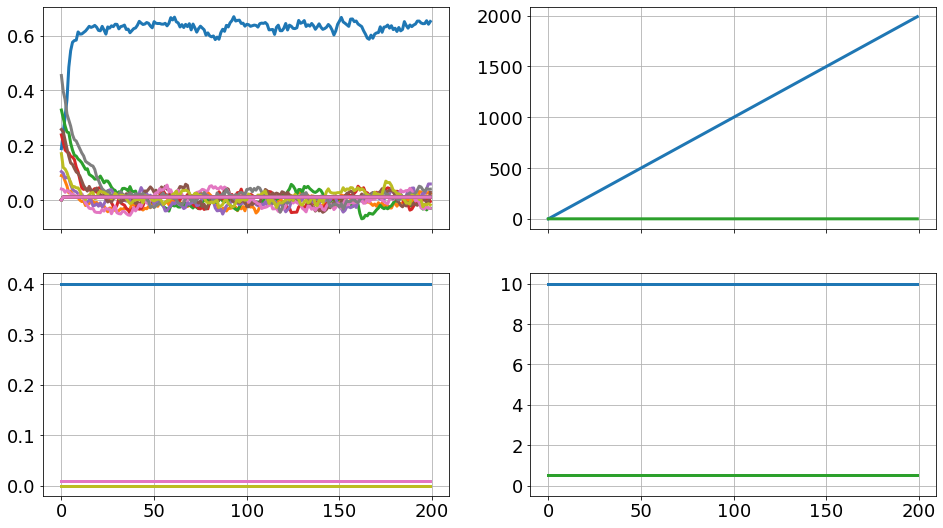

In [7]:
u0 = np.zeros((10,1))
u0[0] += 0.4
u0[-1] += 10
for i in range(200):
    #sim.make_step(u0)
    y0 = sim.make_step(u0, w0=0.01*np.random.randn(model.n_w,1))
    print(y0)
    x0 = mhe.make_step(y0)
sim_graphics.plot_results()
mhe_graphics.plot_results()
# Reset the limits on all axes in graphic to show the data.
sim_graphics.reset_axes()
# Show the figure:
fig

In [10]:
sim.reset_history()
sim.x0 = x0_true
mpc.reset_history()

In [11]:
def day_of_the_week(value):
    if value % 7 == 1:
        return 'mon'
    elif value % 7 == 2:
        return 'tue'
    elif value % 7 == 3:
        return 'wed'
    elif value % 7 == 4:
        return 'thu'
    elif value % 7 == 5:
        return 'fri'
    elif value % 7 == 6:
        return 'sat'
    elif value % 7 == 0:
        return 'sun'
        

In [12]:
#%%capture
for i in range(50):
    # if day_of_the_week(i) == 'tue' or day_of_the_week(i) == 'thu' or day_of_the_week(i) == 'sat'or day_of_the_week(i) == 'sun':
    #   u0 = np.zeros((19,1))
    #    u0[-1] = 24
    # else:
    u0 = mpc.make_step(x0)
    x0 = sim.make_step(u0)
    #print(i)

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:     1124
Number of nonzeros in inequality constraint Jacobian.:       70
Number of nonzeros in Lagrangian Hessian.............:     1927

Total number of variables............................:      291
                     variables with only lower bounds:        7
                variables with lower and upper bounds:      140
                     variables with only upper bounds:       63
Total number of equality constraints.................:      214
Total number of inequality constraints...............:        7
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:        0
        inequality constraints with only upper bounds:        7

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0 -

In [16]:
sim.data._aux

array([[0.00000000e+00, 1.86532815e+00, 9.35135987e-04, ...,
        9.94722590e-01, 1.00000000e+00, 8.00000000e+00],
       [0.00000000e+00, 2.08968578e+00, 9.67159496e-04, ...,
        9.94733588e-01, 1.00000000e+00, 8.00000000e+00],
       [0.00000000e+00, 2.18588116e+00, 3.61267583e-03, ...,
        9.95237677e-01, 1.00000000e+00, 7.00000000e+00],
       ...,
       [0.00000000e+00, 5.42000649e+00, 1.63541060e-02, ...,
        9.96105514e-01, 1.00000000e+00, 6.00000000e+00],
       [0.00000000e+00, 5.40108400e+00, 2.68746230e-03, ...,
        9.94722222e-01, 1.00000000e+00, 1.00000000e+00],
       [0.00000000e+00, 5.40047727e+00, 2.67415579e-03, ...,
        9.94722232e-01, 1.00000000e+00, 7.00000000e+00]])

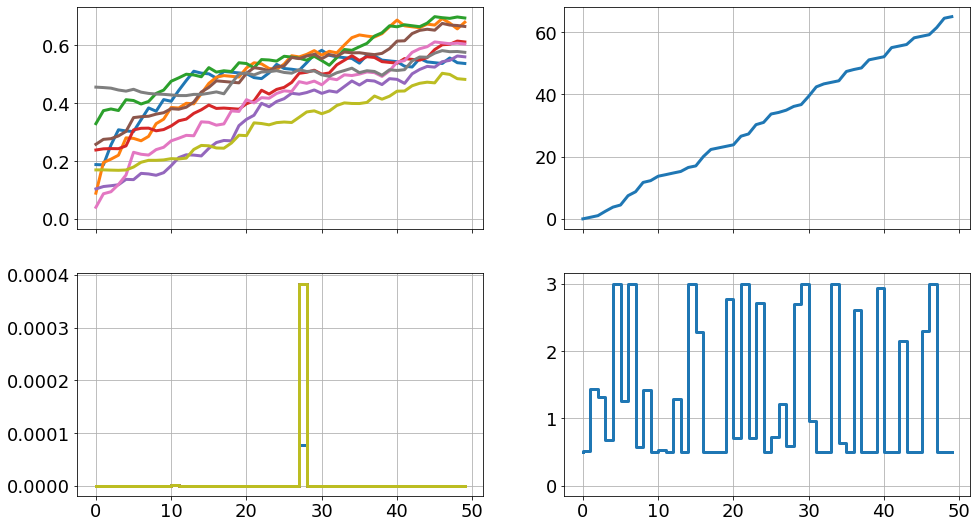

In [13]:
# Plot predictions from t=0
#mpc_graphics.plot_predictions(t_ind=5)
# Plot results until current time
sim_graphics.plot_results()
sim_graphics.reset_axes()
fig

In [14]:
sim.data._z

array([[ 0.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
        -1.00000000e+00, -1.00000000e+00, -1.00000000e+00,
        -1.00000000e+00, -1.00000000e+00, -1.00000000e+00,
        -1.00000000e+00, -1.00000000e+00, -1.00000000e+00],
       [ 1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  1.00000000e+00,  0.00000000e+00,
         5.39599443e-09,  3.16865423e-10,  2.92336877e-09,
         8.77076189e-15,  8.77076189e-15,  5.18454502e-09,
         2.21999596e-09,  8.77076189e-15,  0.00000000e+00],
       [ 1.00000000e+00,  1.00000000e+00,  0.00000000e+00,
         1.00000000e+00,  1.00000000e+00,  1.00000000e+00,
         1.00000000e+00,  0.00000000e+00,  1.00000000e+00,
        -9.99999990e-01, -1.00000000e+00, -1.00000000e+00,
        -1.00000000e+00, -1.00000000e+00, -1.00000000e